<a href="https://colab.research.google.com/github/duythanhcn/computer-vision/blob/master/face_recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


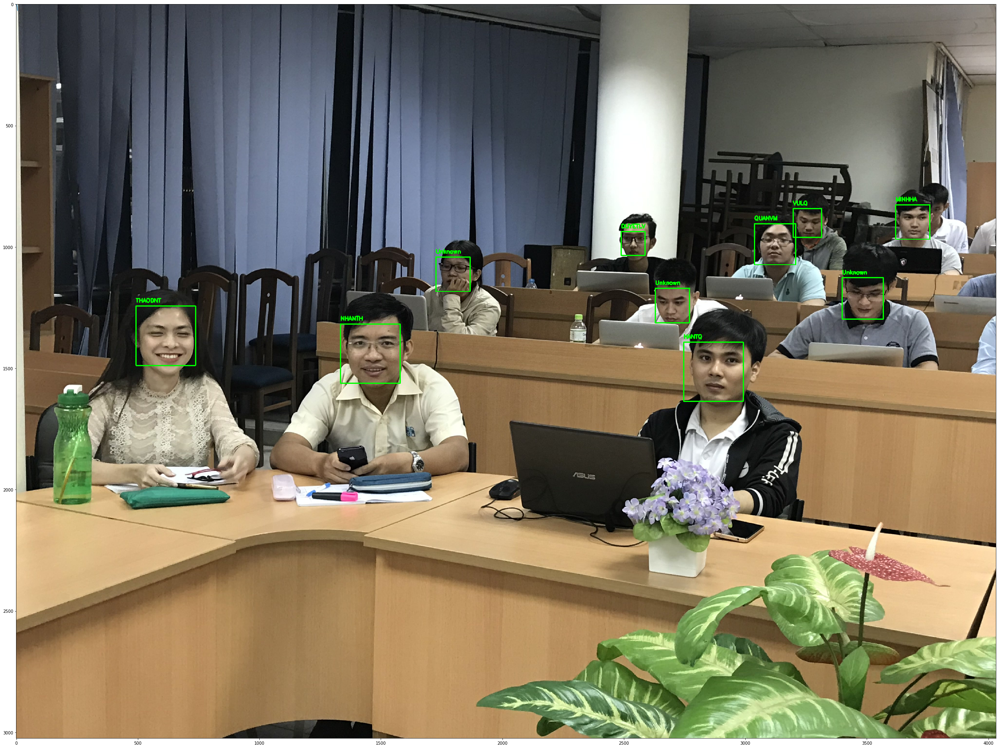

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


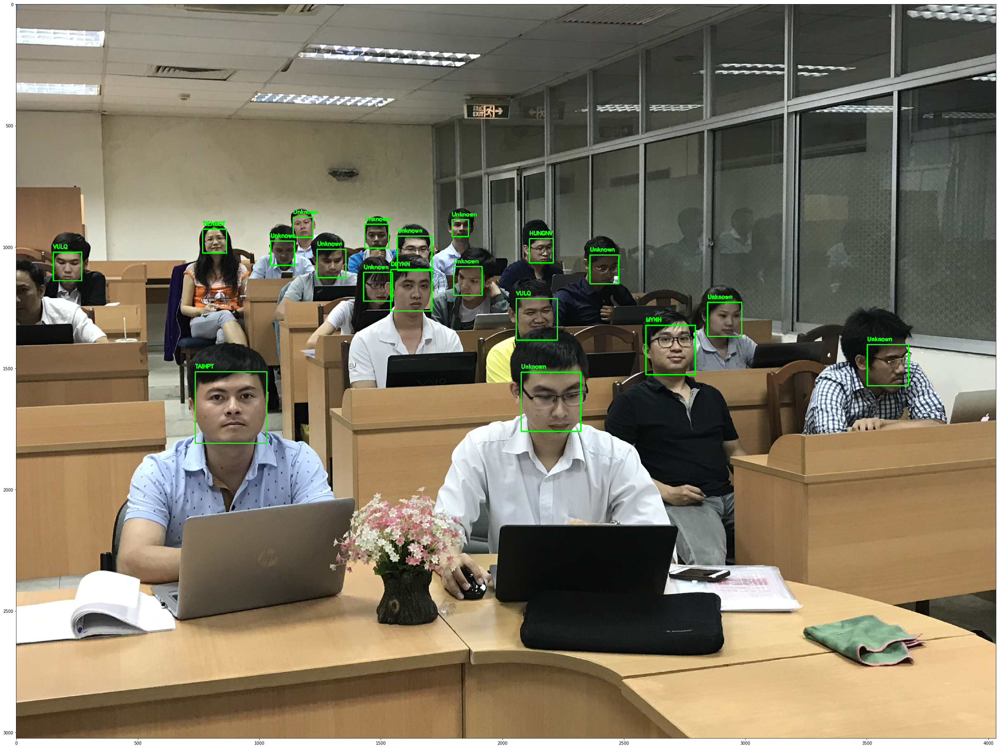

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


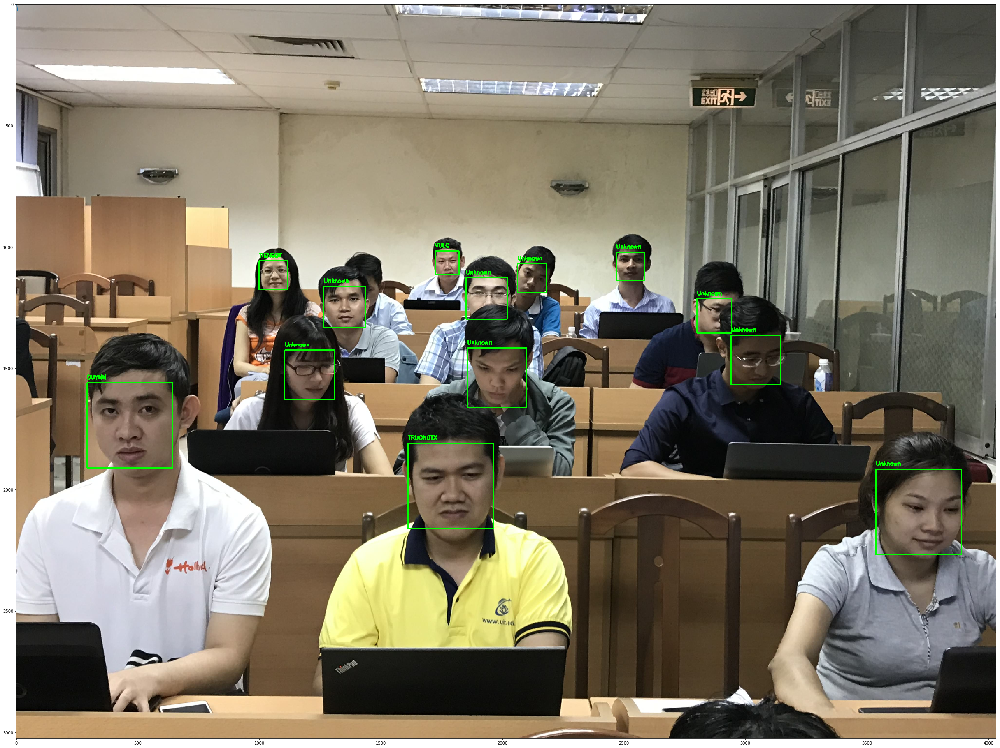

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


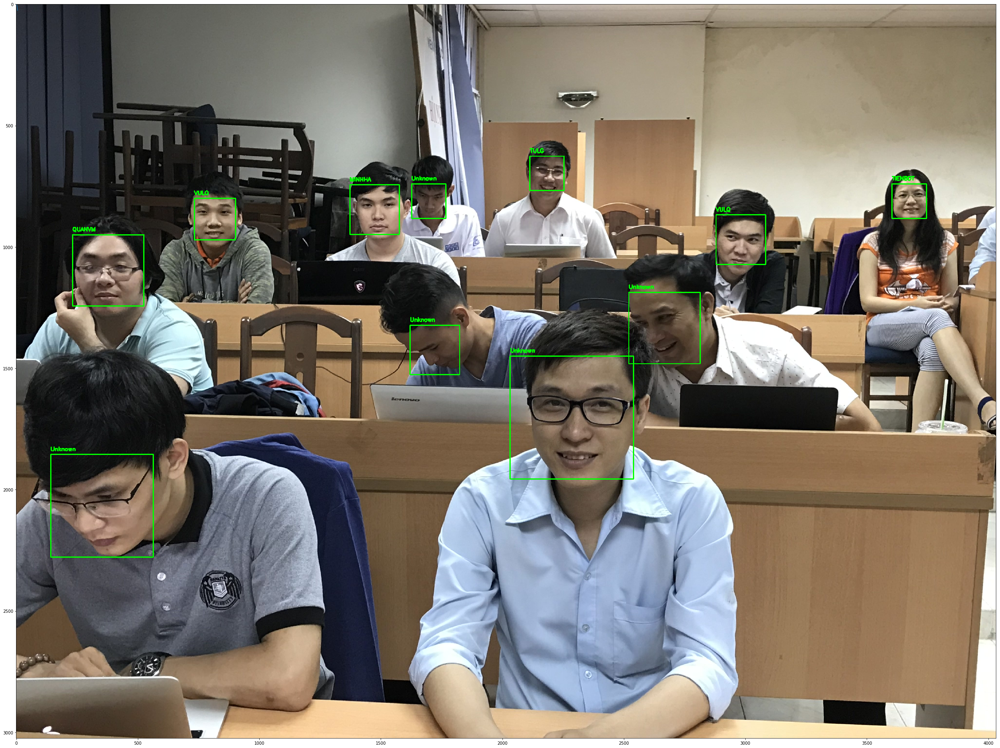

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


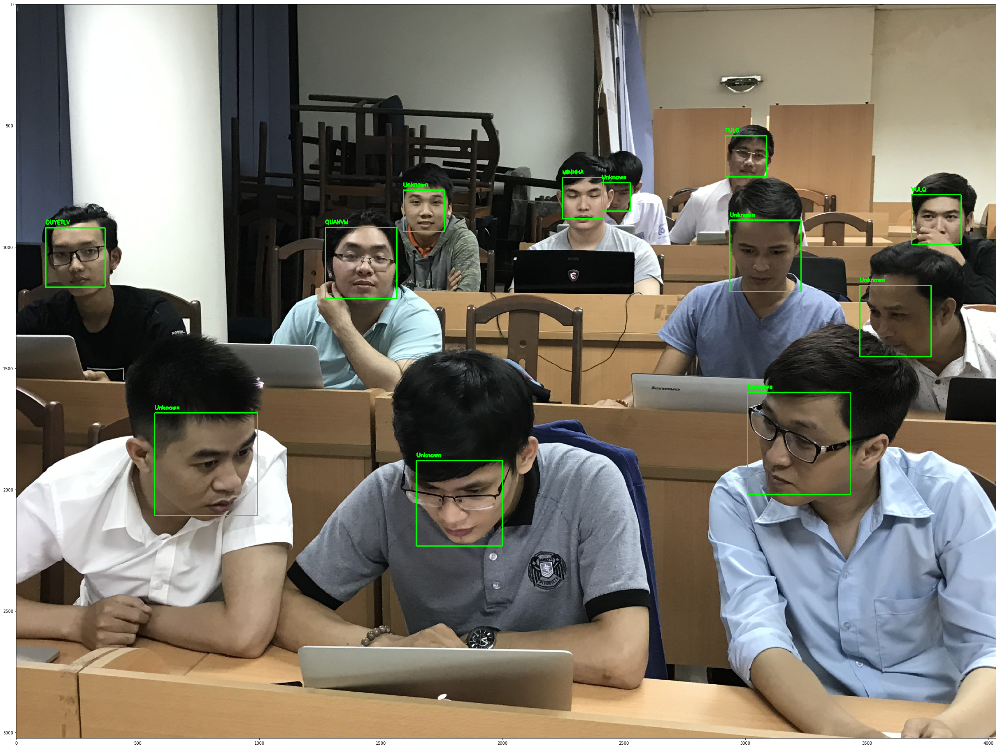

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


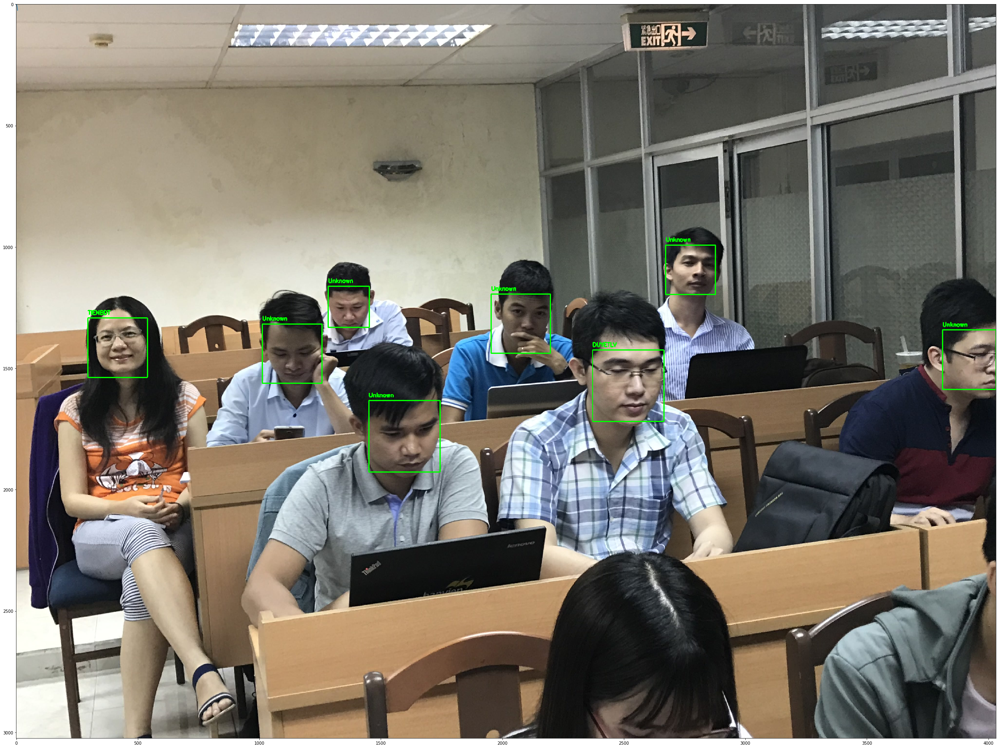

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
[INFO] recognizing faces...
read model


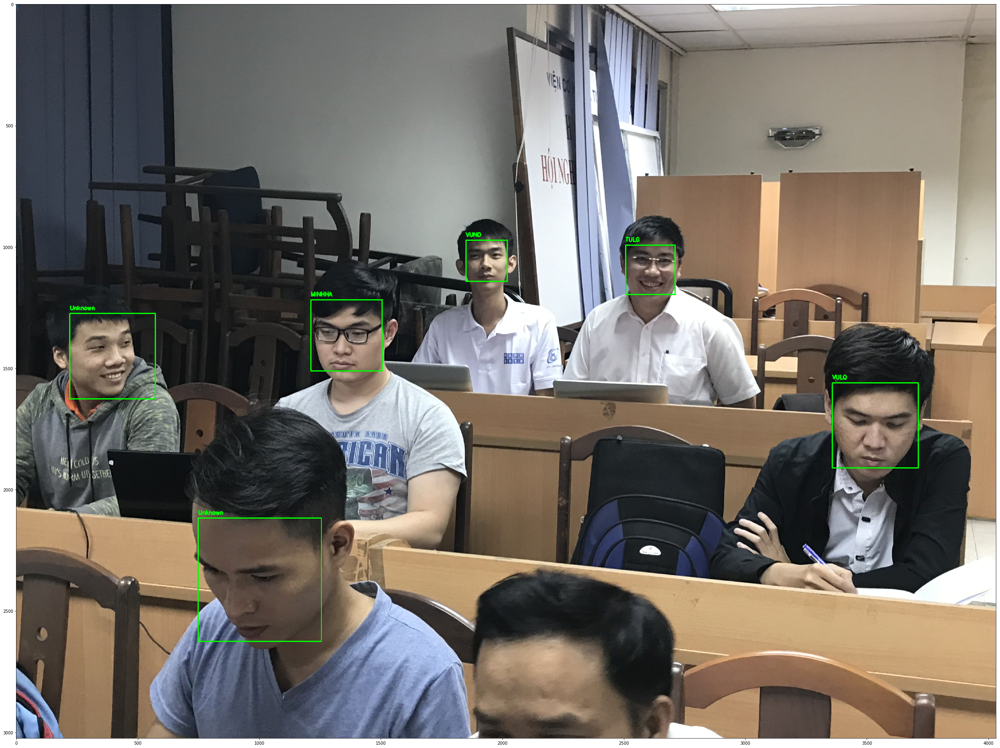

In [0]:
import face_recognition
import cv2
import os
import os.path
import pickle
import matplotlib.pyplot as plt
import numpy as np
from urllib.request import urlopen
from google.colab import drive
  
def detectFace(img_path):
    drive.mount('/content/gdrive')
    image = cv2.imread(img_path)
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    print("[INFO] recognizing faces...")
    path = '/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/encodings.pickle'
    data = []
    with open(path, 'rb') as file:
      unpickler = pickle.Unpickler(file);
      data = unpickler.load();
      
    boxes = face_recognition.face_locations(rgb, model="cnn")
    encodings = face_recognition.face_encodings(rgb, boxes)

    names = []
    for encoding in encodings:
        matches = face_recognition.compare_faces(data["encodings"],encoding, 0.4)
        name = "Unknown"
        if True in matches:
            matchedIdxs = [i for (i, b) in enumerate(matches) if b]
            counts = {}
            for i in matchedIdxs:
                name = data["names"][i]
                counts[name] = counts.get(name, 0) + 1
            name = max(counts, key=counts.get)
        names.append(name)
  
    # loop over the recognized faces
    for ((top, right, bottom, left), name) in zip(boxes, names):
        # draw the predicted face name on the image
        cv2.rectangle(image, (left, top), (right, bottom), (0, 255, 0), 4)
        y = top - 15 if top - 15 > 15 else top + 15
        cv2.putText(image, name, (left, y), cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0, 255, 0), 4)

    # show the output image
    
    img_cvt = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    fig= plt.figure(figsize=(116,31))
    axes= fig.add_axes([0.1,0.1,0.8,0.8])
    x= [1,2,3,4,5]
    y=[x**2 for x in x]
    axes.plot(x,y)
    plt.imshow(img_cvt)
    plt.show()
    
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5326.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5327.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5328.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5329.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5330.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5331.jpg')
detectFace('/content/gdrive/My Drive/Colab Notebooks/CV_COLAB/Final/input/IMG_5332.jpg')

def recogizeFace(target_face_encoding):
#     target_face_encoding = face_recognition.face_encodings(target_face)
    # load the known faces and embeddings
    print("[INFO] loading encodings...")
    data = pickle.loads(open("encodings.pickle", "rb").read())
    # loop over the facial embeddings
    name = "Unknown"
    matches = face_recognition.compare_faces(data["encodings"], target_face_encoding)
    # check to see if we have found a match
    if True in matches:
        matchedIdxs = [i for (i, b) in enumerate(matches) if b]
        counts = {}
        for i in matchedIdxs:
            name = data["names"][i]
            counts[name] = counts.get(name, 0) + 1
        name = max(counts, key=counts.get)

    return name
    
    
def trainModel():
    path = './dataset'
    knownEncodings = []
    knownNames = []
    # r=root, d=directories, f = files
    index = 0
    print("start load dataset to training")
    for r, d, f in os.walk(path):
        for folder in d:
            for r1, d1, f1 in os.walk(os.path.join(r, folder)):
                for file in f1:
                    print(os.path.join(r, folder, file))
                    image_loaded = face_recognition.load_image_file(os.path.join(r, folder, file))
                    face_encodings = face_recognition.face_encodings(image_loaded)
                    arrFile.append(face_encoding)
                    # loop over the encodings
                    for encoding in face_encodings:
                        # add each encoding + name to our set of known names and
                        # encodings
                        knownEncodings.append(encoding)
                        knownNames.append(name)
                        
    print("encoding done")
    print("start write data to file")
    print("[INFO] serializing encodings...")
    data = {"encodings": knownEncodings, "names": knownNames}
    f = open("encodings.pickle", "wb")
    f.write(pickle.dumps(data))
    f.close()
    print("training done")